In [13]:
!nvidia-smi

Tue Oct 15 09:17:13 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8               9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [14]:
!pip install ultralytics

In [15]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.2/112.6 GB disk)


In [16]:
from ultralytics import YOLO
from IPython.display import Image

In [17]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="fKCKsAc1W7sgnvYWYqT4")
project = rf.workspace("defencesystem").project("defencecraft_system")
version = project.version(6)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to DefenceCraft_System-6 in yolov11:: 100%|██████████| 1160/1160 [00:00<00:00, 7328.10it/s]


In [18]:
dataset.location

'/content/DefenceCraft_System-6'

In [19]:
!yolo task=detect mode=train data={dataset.location}/data.yaml model="yolo11n.pt" epochs=100 imgsz=640

100% 5.35M/5.35M [00:00<00:00, 83.9MB/s]
Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/DefenceCraft_System-6/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_

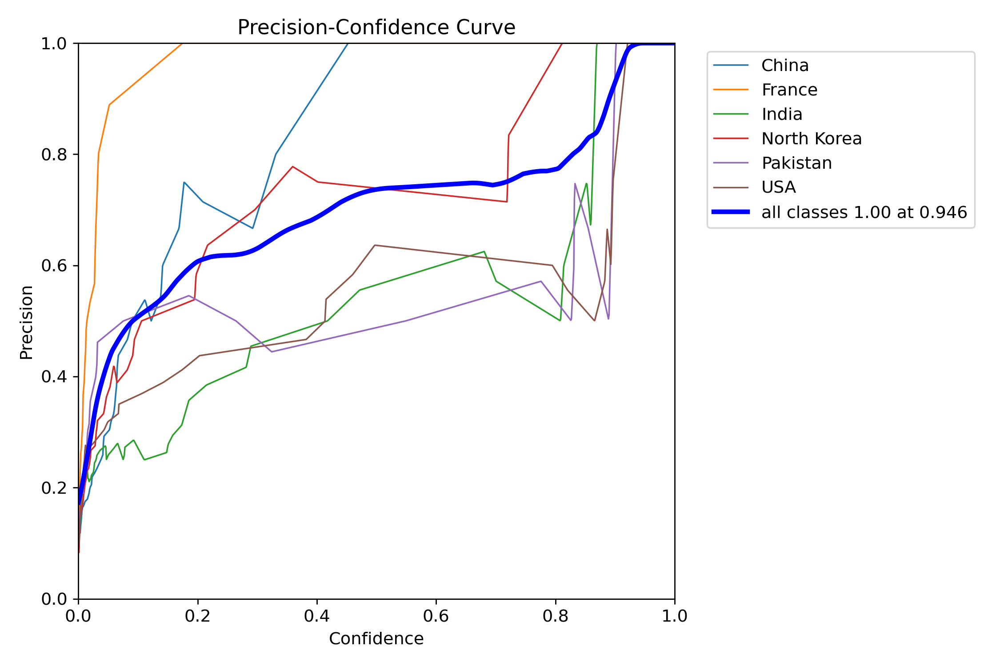

In [20]:
Image("/content/runs/detect/train/P_curve.png", width=600)

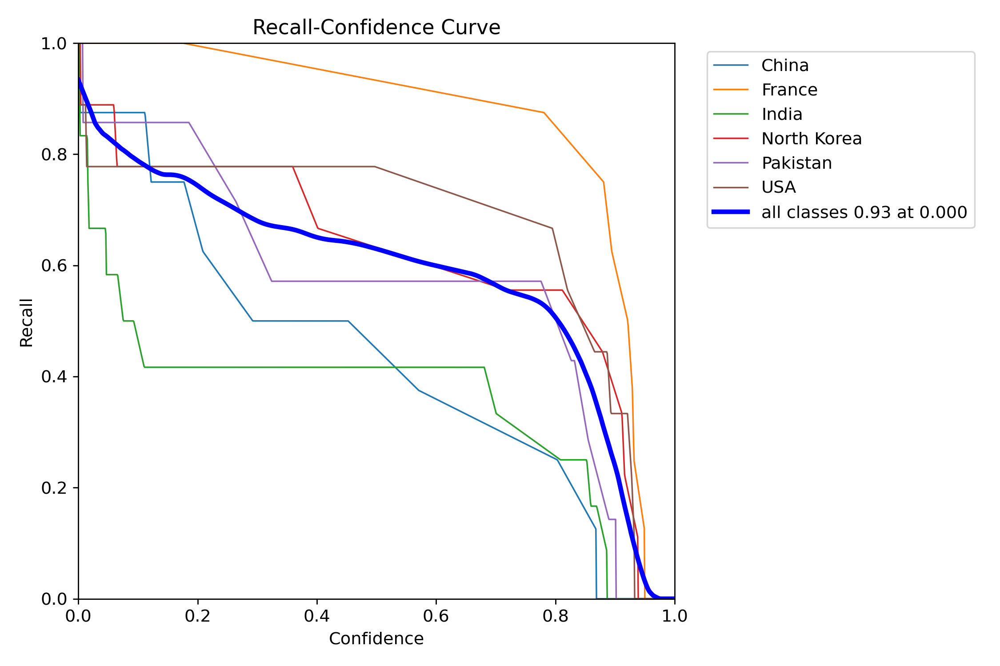

In [21]:
Image("/content/runs/detect/train/R_curve.png", width=600)

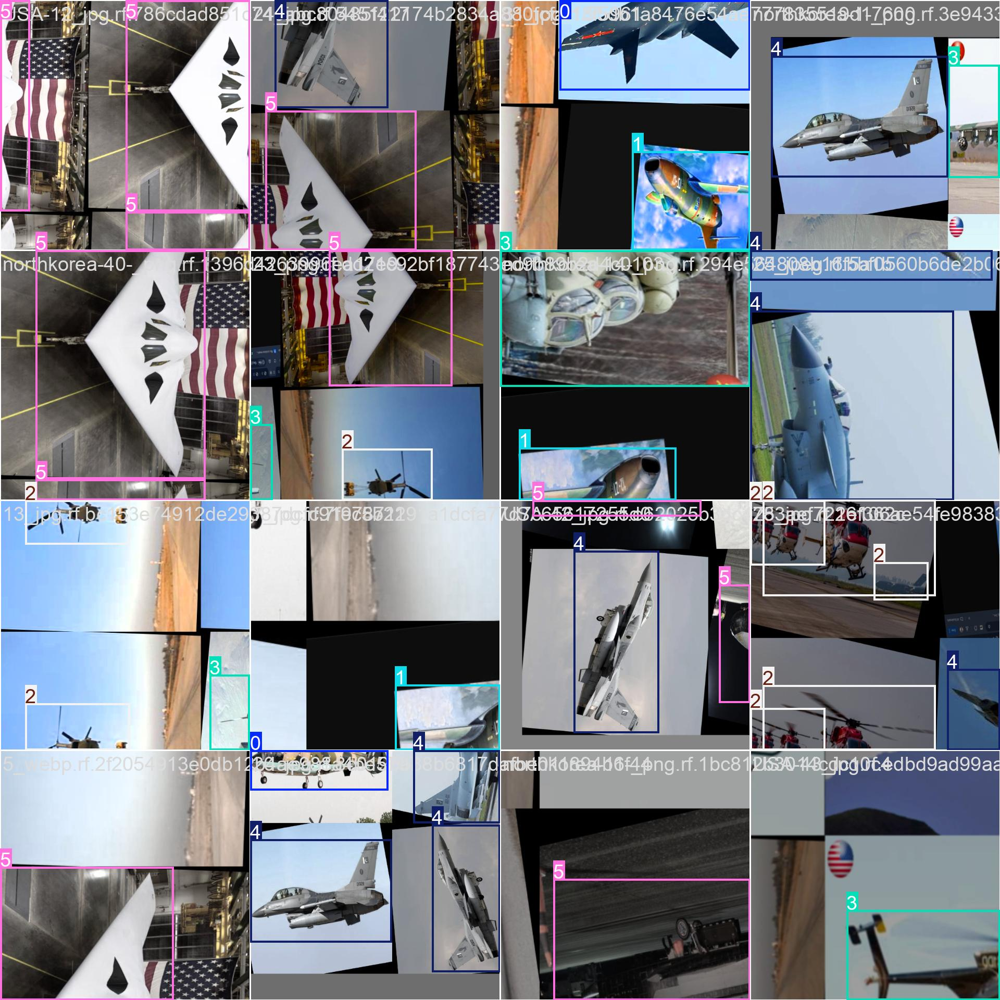

In [22]:
Image("/content/runs/detect/train/train_batch1.jpg", width=600)

In [23]:
import os
from google.colab import drive
import glob

In [24]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [25]:
!mv /content/runs/detect/train/weights/best.pt /content/drive/MyDrive/FINAL_YOLO_V11

In [26]:
!mv /content/runs /content/drive/MyDrive/FINAL_YOLO_V11

In [28]:
!gdown "https://drive.google.com/uc?id=1xglrE446KoEHuXf7iBZWbHAEjQEik6ZZ&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1xglrE446KoEHuXf7iBZWbHAEjQEik6ZZ&confirm=t
To: /content/best.pt
100% 5.48M/5.48M [00:00<00:00, 37.6MB/s]


In [29]:
!yolo task=detect mode=val model="best.pt" data={dataset.location}/data.yaml

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,322 parameters, 0 gradients, 6.3 GFLOPs
val: Scanning /content/DefenceCraft_System-6/valid/labels.cache... 49 images, 0 backgrounds, 0 corrupt: 100% 49/49 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 4/4 [00:02<00:00,  1.77it/s]
                   all         49         53      0.731      0.638      0.715      0.578
                 China          8          8          1      0.482      0.768      0.653
                France          8          8          1      0.939      0.995       0.73
                 India          8         12      0.557      0.417      0.459      0.399
           North Korea          9          9      0.742      0.643       0.79       0.62
              Pakistan          7          7      0.481      0.571      0.623      0.539
                   USA          9          9 

In [30]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,322 parameters, 0 gradients, 6.3 GFLOPs

image 1/23 /content/DefenceCraft_System-6/test/images/10_jpg.rf.d143701482d32f7d405c14c66719feb4.jpg: 640x640 1 North Korea, 9.9ms
image 2/23 /content/DefenceCraft_System-6/test/images/13_png.rf.cb53d72ddc1e6baeb114ce884e358e0d.jpg: 640x640 1 France, 8.9ms
image 3/23 /content/DefenceCraft_System-6/test/images/15_jpg.rf.24443a61ecedfcb71c62a0bd7420a853.jpg: 640x640 1 China, 8.3ms
image 4/23 /content/DefenceCraft_System-6/test/images/1_jpg.rf.10dfa433122bb231abbe5a0b6c0d684f.jpg: 640x640 1 USA, 7.9ms
image 5/23 /content/DefenceCraft_System-6/test/images/20_png.rf.90fddaae28da996815219060fc054ae0.jpg: 640x640 1 France, 8.2ms
image 6/23 /content/DefenceCraft_System-6/test/images/21_png.rf.b470798cd2a29e3c7e9fbed8cb1f1980.jpg: 640x640 1 France, 7.9ms
image 7/23 /content/DefenceCraft_System-6/test/images/22_jpg.rf.6281d0515427d3

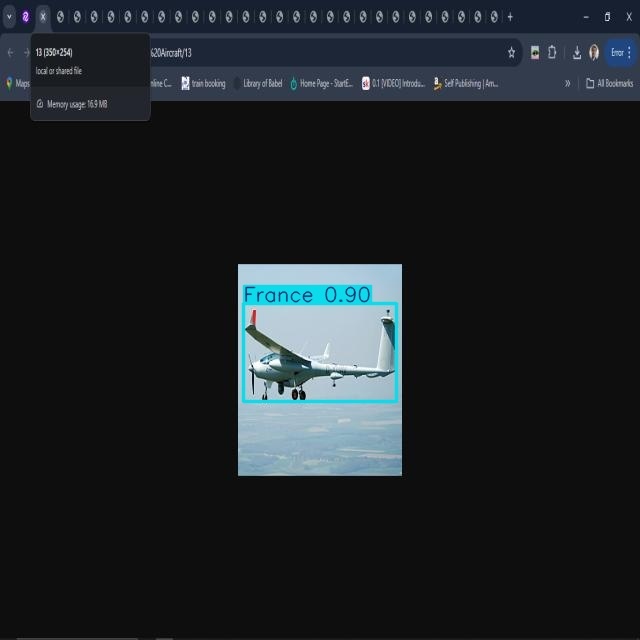

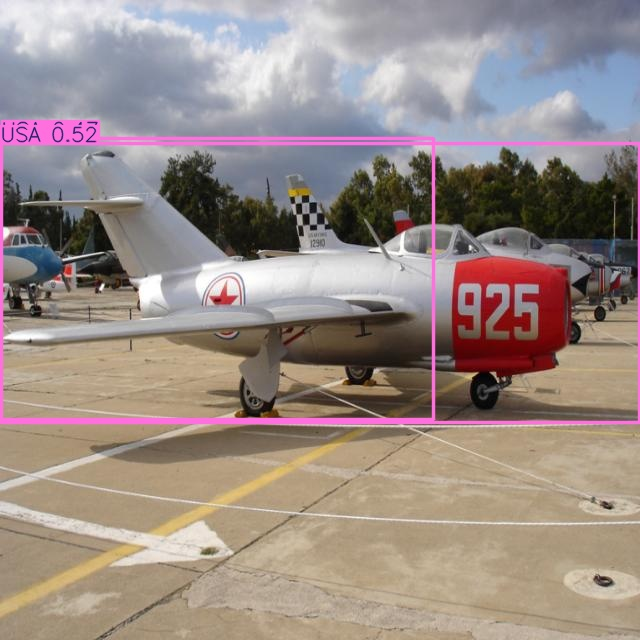

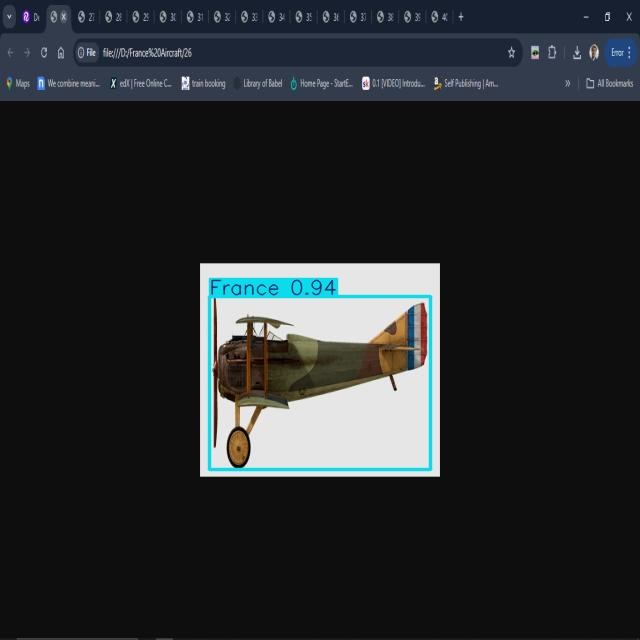

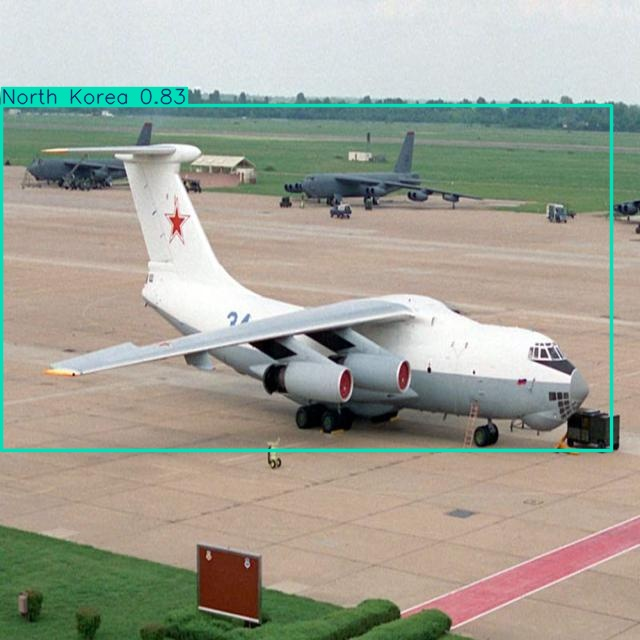

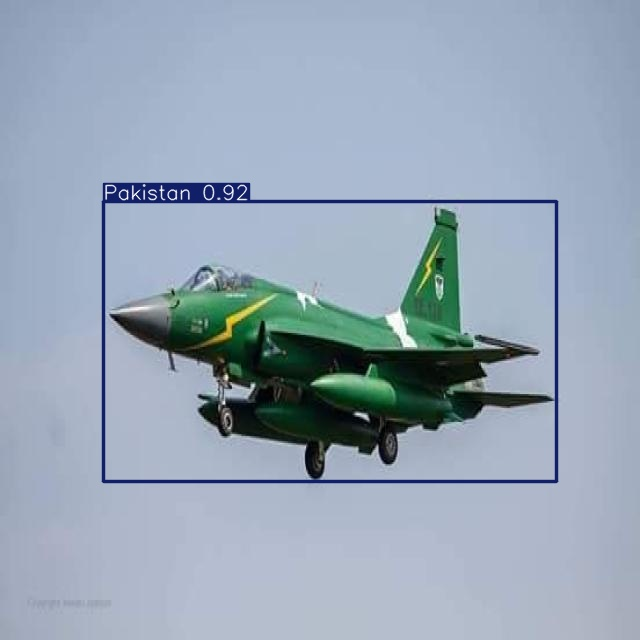

...

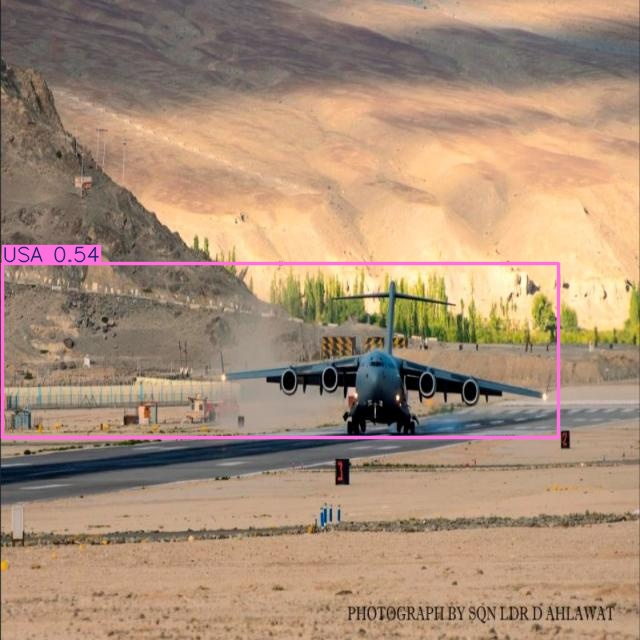

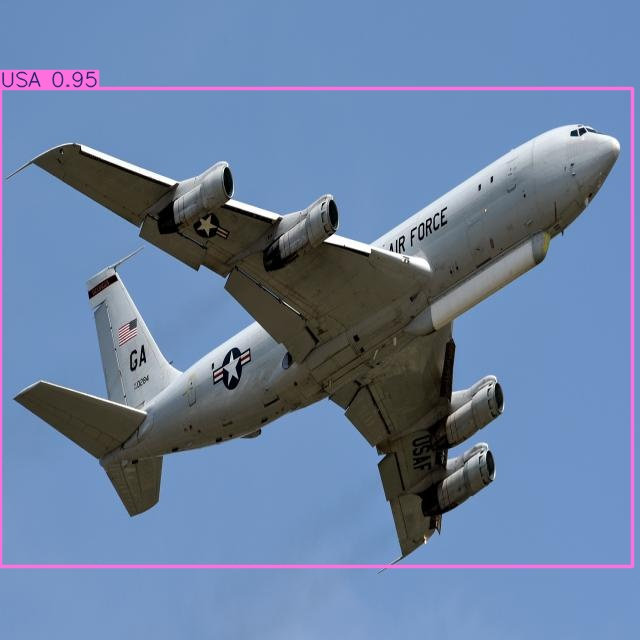

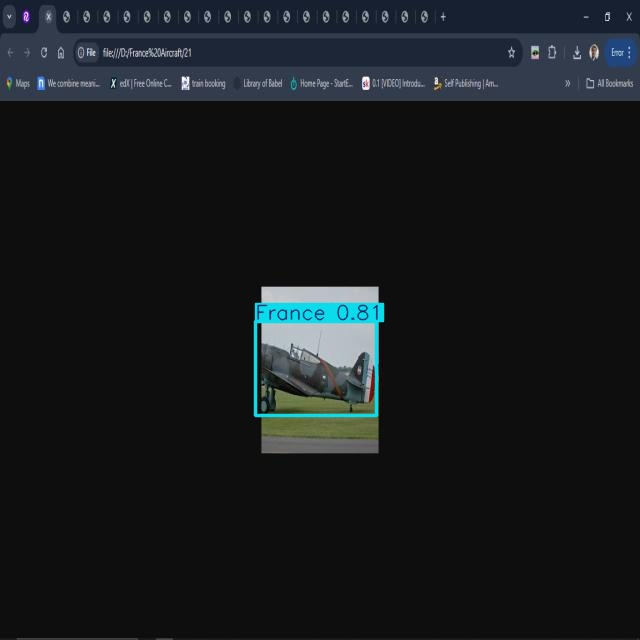

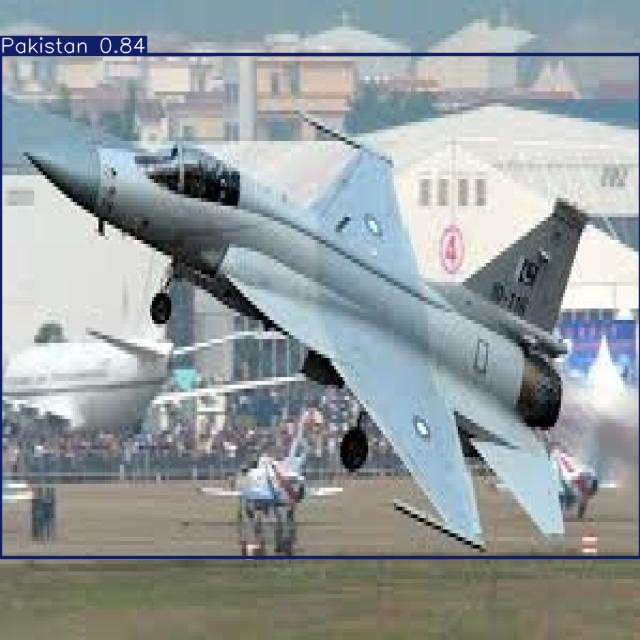

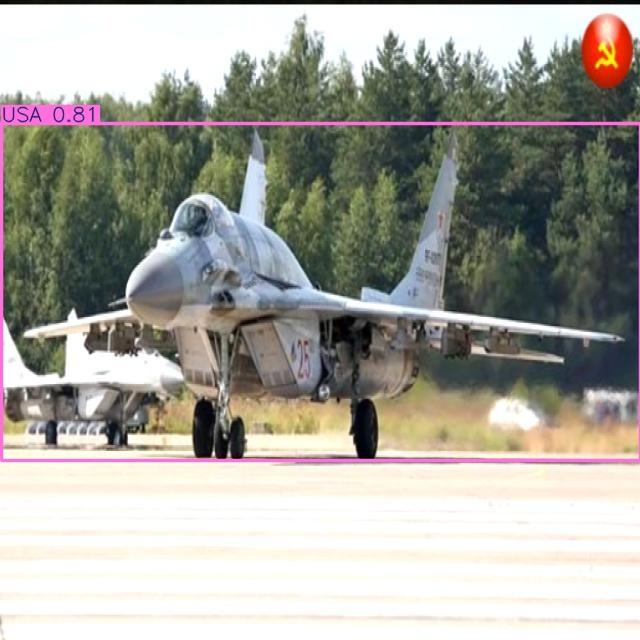

In [31]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:]:
    display(IPyImage(filename=img, width=600))
    print("\n")

In [ ]:
https://drive.google.com/file/d/1mTNhnEBA2Cf5oDJr64RrQmZuE8RbHAYp/view?usp=sharing

In [32]:
!gdown "https://drive.google.com/uc?id=1mTNhnEBA2Cf5oDJr64RrQmZuE8RbHAYp&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1mTNhnEBA2Cf5oDJr64RrQmZuE8RbHAYp&confirm=t
To: /content/us.mp4
100% 25.1M/25.1M [00:01<00:00, 24.4MB/s]


In [33]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source="us.mp4" save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,322 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/1330) /content/us.mp4: 384x640 1 China, 47.2ms
video 1/1 (frame 2/1330) /content/us.mp4: 384x640 1 China, 9.8ms
video 1/1 (frame 3/1330) /content/us.mp4: 384x640 1 China, 10.7ms
video 1/1 (frame 4/1330) /content/us.mp4: 384x640 1 China, 8.2ms
video 1/1 (frame 5/1330) /content/us.mp4: 384x640 1 China, 10.0ms
video 1/1 (frame 6/1330) /content/us.mp4: 384x640 1 China, 8.9ms
video 1/1 (frame 7/1330) /content/us.mp4: 384x640 1 China, 9.2ms
video 1/1 (frame 8/1330) /content/us.mp4: 384x640 1 China, 9.6ms
video 1/1 (frame 9/1330) /content/us.mp4: 384x640 1 China, 8.9ms
video 1/1 (frame 10/1330) /content/us.mp4: 384x640 1 China, 9.3ms
video 1/1 (frame 11/1330) /content/us.mp4: 384x640 1 China, 10.4ms
video 1/1 (frame 12/1330) /content/us.mp4: 384x640 1 China, 8.7ms
video 1/1 (frame 13/1330) /content/us.mp4: 384x

In [34]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict2/us.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
https://drive.google.com/file/d/1H332MToV8xOCRTbd8BSnFxIVoYuZA7Vg/view?usp=drive_link

In [35]:
!gdown "https://drive.google.com/uc?id=1H332MToV8xOCRTbd8BSnFxIVoYuZA7Vg&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1H332MToV8xOCRTbd8BSnFxIVoYuZA7Vg&confirm=t
To: /content/france.jpg
100% 100k/100k [00:00<00:00, 4.26MB/s]


In [37]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source=france.jpg save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,322 parameters, 0 gradients, 6.3 GFLOPs

image 1/1 /content/france.jpg: 384x640 1 India, 1 Pakistan, 46.8ms
Speed: 3.6ms preprocess, 46.8ms inference, 557.0ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


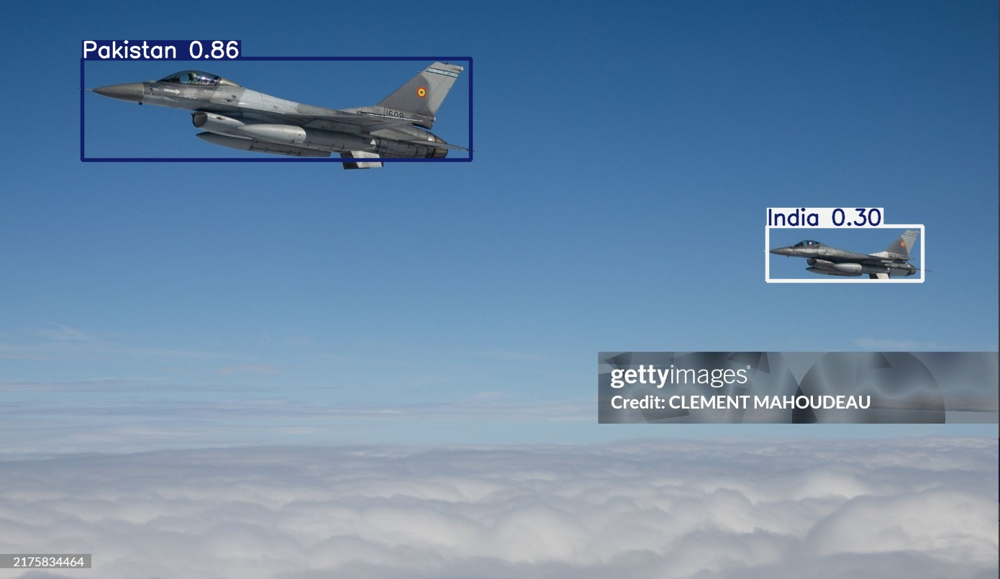

In [38]:
Image("/content/runs/detect/predict3/france.jpg", width=600)